# Structural cereal model

In [1]:
#| echo: false

# Ignore warning about depreciated modules
import warnings
warnings.filterwarnings('ignore', category=DeprecationWarning)

In [2]:
# | echo: false

# Import path of model
# import sys
# # caution: path[0] is reserved for script path (or '' in REPL)
# sys.path.insert(1, './src')

In [3]:
#| echo: false

# Enable interactive plotting
%matplotlib ipympl

In this section, we define a static structural model for cereals.  
The paragraphs are organized so that it is easy to see how the model is built and how we can play with parameters.  

Some 3D plots are interactive, don't hesitate to rotate them.

## Create a parametric leaf

The leaf blade is represented as a surface.  
A parametric leaf is here defined by sample points (here 12), described by two sets of coordinates:  
- $(x,y)$: coordinates for the midrib in a vertical plane, give the curvature of the leaf;  
- $(s,r)$: curviliear abcissa (i.e. length along midrib) and relative length-dependent leaf width.

Note that $s$ can be expressed as a function of $x$ and $y$, at point $p \neq 0$, as follows: $ s_p(x,y) = \sqrt{(x_p-x_{p-1})^2+(y_p-y_{p-1})^2} $.  

The origin represents the leaf base.  

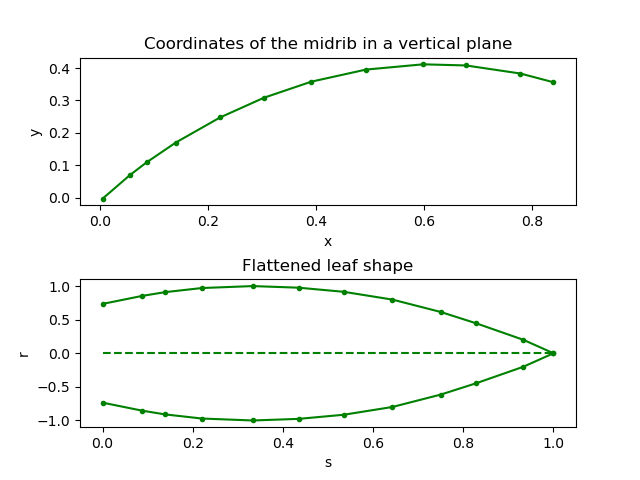

In [4]:
## Imports

# from installed packages
import numpy as np
import matplotlib.pyplot as plt
from heapq import *
from scipy.interpolate import splprep, splev
from scipy.integrate import simps, trapz
from openalea.plantgl.all import Vector3

# from archicrop
from archicrop.cereals_leaf import leaf_shape_perez, sr_prevot, parametric_leaf
# or
# from archicrop.simple_maize import leaf_shape_perez, sr_prevot, parametric_leaf
# from archicrop.fitting import leaf_shape_perez
from archicrop.generator import curvilinear_abscisse
from archicrop.fitting import fit2, fit3, simplify
from archicrop.simplification import distance, cost

## Code for generating a parametric leaf for a cereal 
pl=parametric_leaf(nb_segment=10, insertion_angle=40, scurv=0.7, curvature=70, alpha=-2.3)

fig, (ax1, ax2) = plt.subplots(nrows=2) 
# fig.suptitle('Parametric leaf')

ax1.plot(pl[0], pl[1], '.-', c="green")
ax1.set_xlabel('x')
ax1.set_ylabel('y')
ax1.set_title("Coordinates of the midrib in a vertical plane")

ax2.plot(pl[2], pl[3], '.-', c="green")
ax2.plot(pl[2], -pl[3], '.-', c="green")
ax2.plot(np.arange(0,1.1,0.1), np.zeros(11), c="green", ls="dashed")
ax2.set_xlabel('s')
ax2.set_ylabel('r')
ax2.set_title("Flattened leaf shape")

plt.subplots_adjust(hspace=0.5)

plt.show()

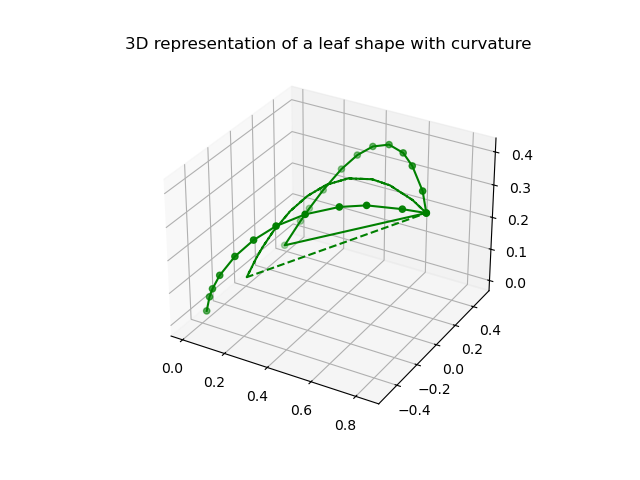

In [5]:
## Imports

# from installed packages
from mpl_toolkits.mplot3d import Axes3D
from scipy.interpolate import interp2d
import matplotlib.tri as mtri

# from archicrop
from archicrop.fitting import leaf_to_mesh_2d

## Code for representing the parametric leaf in 3D (ignore excess lines)
x=pl[0]
y=pl[1]
s=pl[2]
r=pl[3]

pts,ind=leaf_to_mesh_2d(x, y, r)

xs=[pt[0] for pt in pts]
ys=[pt[1] for pt in pts]
zs=[pt[2] for pt in pts]
    
X,Y=np.meshgrid(xs, ys)

tri=mtri.Triangulation(xs, ys)

fig=plt.figure()
ax=fig.add_subplot(111, projection='3d')
ax.scatter(xs,ys,zs,c="green")
ax.plot(xs,ys,zs,c="green")
ax.plot(xs,np.zeros(len(ys)),zs,c="green",ls="dashed")
ax.set_title("3D representation of a leaf shape with curvature")
plt.show()

Please ignore excess straight lines.

## Generate leaf azimuth series

Leaves grow around an axis with a given phyllotaxy, represented here as an angle from leaf to leaf (e.g. spiral with a given angle or alternate distichous = $180^o$).  

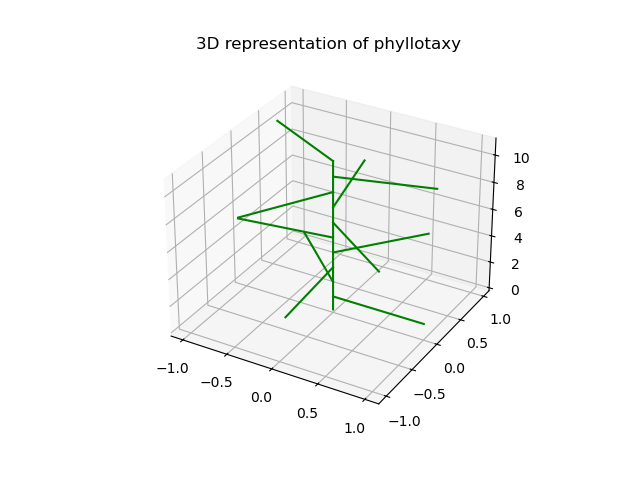

In [6]:
## Imports

# from installed packages 
# from itertools import cycle

# from archicrop
from archicrop.plant_design import leaf_azimuth

## Code for generating leaf azimuths series for a given phyllotaxy
nb_phy=10
phyllotactic_angle=137
spiral=True
phyllotactic_deviation=0
plant_orientation=0

la=leaf_azimuth(size=nb_phy, 
                phyllotactic_angle=phyllotactic_angle, 
                phyllotactic_deviation=phyllotactic_deviation, 
                plant_orientation=plant_orientation, 
                spiral=spiral)

x=np.cos(la*np.pi/180)
y=np.sin(la*np.pi/180)
z=np.linspace(1,len(la)+1,len(la))

fig,ax=plt.subplots(subplot_kw=dict(projection='3d'))
for i,a in enumerate(la):
    ax.plot(np.linspace(0,x[i],2), np.linspace(0,y[i],2), [z[i],z[i]], c="green")
ax.plot([0,0], [0,0], [0,z[-1]], c="green")

ax.set_title("3D representation of phyllotaxy")

plt.show()

## Manage internode lengths

Internodes on an axis have varying lengths. The repartition of their lengths along the axis can be approximated with a geometric model.

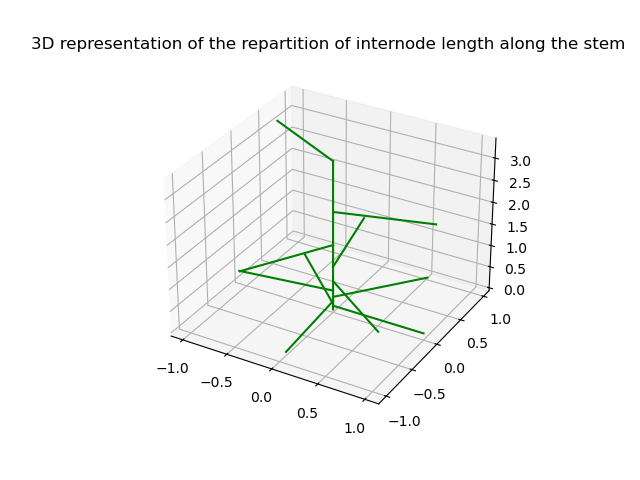

In [7]:
## Imports
from archicrop.plant_shape import geometric_dist

## Code for applying lengths to internodes according to a geometric model
plant_height=15
q=1.5

x=np.cos(la*np.pi/180)
y=np.sin(la*np.pi/180)
z=geometric_dist(height=plant_height, 
                   nb_phy=nb_phy, 
                   q=q)

fig,ax=plt.subplots(subplot_kw=dict(projection='3d'))
for i,a in enumerate(la):
    ax.plot(np.linspace(0,x[i],2), np.linspace(0,y[i],2), [z[i],z[i]], c="green")
ax.plot([0,0], [0,0], [0,z[-1]], c="green")

ax.set_title("3D representation of the repartition of internode length along the stem")

plt.show()

## Manage leaf lengths as a function of height

Leaves that grow on an axis have varying lengths. The repartition of their lengths along the axis can be approximated with a bell shaped model.

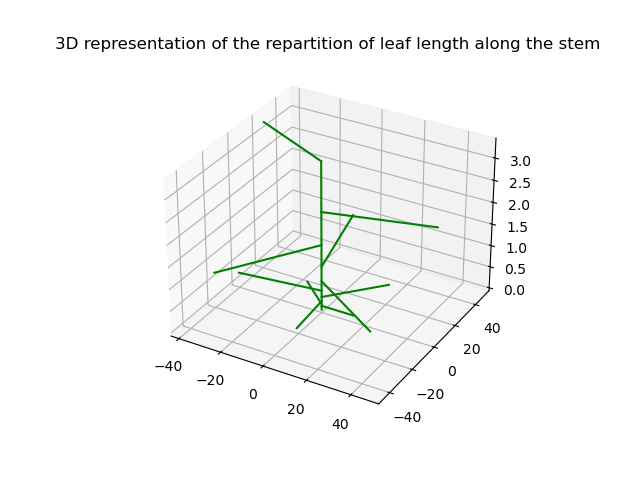

In [8]:
## Imports
from archicrop.plant_shape import bell_shaped_dist

## Code for applying lengths to leaves according to a bell shaped model
max_leaf_length=50

bsd=bell_shaped_dist(max_leaf_length=max_leaf_length, 
                     nb_phy=nb_phy, 
                     rmax=.8, 
                     skew=0.15)

x=np.cos(la*np.pi/180)*bsd
y=np.sin(la*np.pi/180)*bsd
z=geometric_dist(height=plant_height, 
                   nb_phy=nb_phy, 
                   q=q)

fig, ax = plt.subplots(subplot_kw=dict(projection='3d'))
for i,a in enumerate(la):
    ax.plot(np.linspace(0,x[i],2), np.linspace(0,y[i],2), [z[i],z[i]], c="green")
ax.plot([0,0], [0,0], [0,z[-1]], c="green")

ax.set_title("3D representation of the repartition of leaf length along the stem")

plt.show()

## Arrange a leaf to be placed along a stem with a given inclination.

A leaf must undergo a translation to be placed against the surface of the stem (tangent to it), and a rotation to be tilted like the stem (inclination = 1 if main stem).

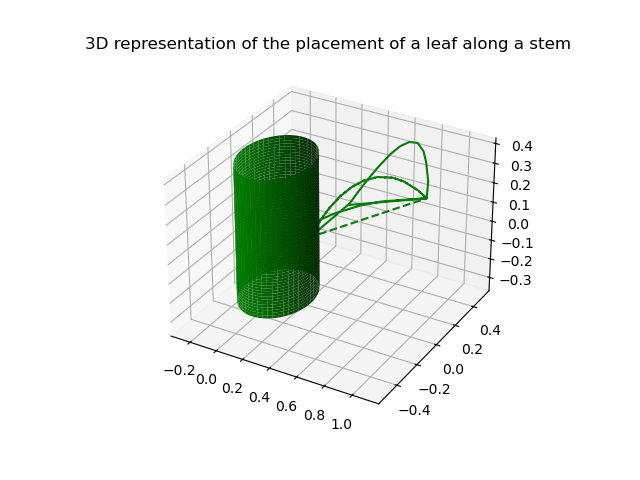

In [9]:
## Imports

# from installed packages
from math import pi, cos, sin, radians
import openalea.plantgl.all as pgl

# from archicrop
# from archicrop.cereals_leaf import arrange_leaf
# or 
from archicrop.geometry import arrange_leaf

## Code for placing a leaf against a stem element (here a cylinder), with a given inclination
stem_diameter=0.5
inclination=1

al=arrange_leaf(leaf=pl, 
                stem_diameter=stem_diameter, 
                inclination=inclination, 
                relative=True)

x=al[0]
y=al[1]
s=al[2]
r=al[3]

pts,ind=leaf_to_mesh_2d(x, y, r)

xs=[pt[0] for pt in pts]
ys=[pt[1] for pt in pts]
zs=[pt[2] for pt in pts]
    
X,Y=np.meshgrid(xs, ys)

tri=mtri.Triangulation(xs, ys)

fig=plt.figure()
ax=fig.add_subplot(111, projection='3d')
ax.plot(xs,ys,zs,c="green")
ax.plot([xs[0],xs[0]],[ys[0],-ys[0]],[0,0],c="green")
ax.plot(xs,np.zeros(len(ys)),zs,c="green",ls="dashed")

radius=stem_diameter/2
z=np.linspace(-zs[-1], zs[-1])
theta=np.linspace(0, 2*np.pi)
theta_grid, z_stem=np.meshgrid(theta, z)
x_stem=radius*np.cos(theta_grid)
y_stem=radius*np.sin(theta_grid)

ax.plot_surface(x_stem, y_stem, z_stem, color="green")

ax.set_title("3D representation of the placement of a leaf along a stem")

plt.show()

## Build the whole plant shoot in 3D, as an MTG.

An MTG (Multiscale Tree Graph) is created as a representation of a parametrized cereal shoot.  
The different scales are: 
- Plant  
- Axis  
- Metamer  
- Stem / Leaf  
- StemElement / LeafElement  

In [10]:
## Imports

# from installed packages
import openalea.plantgl.all as pgl
from openalea.mtg.turtle import TurtleFrame
from openalea.mtg import MTG, fat_mtg
from scipy.interpolate import interp1d
import pandas

# from archicrop
from archicrop.geometry import slim_cylinder, stem_mesh, _is_iterable, as_tuples, addSets, leaf_mesh, compute_element, mtg_interpreter
# from archicrop.cereals_leaf import leaf_mesh
from archicrop.geometry import CerealsTurtle, CerealsVisitor
from archicrop.fitting import leaf_element, leaf_to_mesh_2d, leaf_to_mesh, mesh4, plantgl_shape   # leaf_to_mesh_new ?
from archicrop.plant_design import get_form_factor, blade_dimension, stem_dimension
from archicrop.generator import majors_axes_regression, line_projection, as_leaf, as_plant, cereals as cereals_generator
# not neccessary to import, but useful to see which functions are used 


def build_shoot(stem_radius, insertion_heights, leaf_lengths, leaf_areas, leaf_azimuths=None, leaf_shapes=None):
    """create a shoot

    Args:
        stem_radius: (float) the stem radius
        insertion_heights: list of each leaf insertion height
        leaf_lengths: list of each leaf length (blade length)
        leaf_areas: list of each blade area
        collar_visible: list of each collar height or True if the collar is visible and False if it is not
        leaf_shapes: list of each leaf shape, if it is not known write None
        leaf_azimuths: list of each leaf azimuth, if it is not known write None

    Returns:
        shoot: 

    """
    ranks = range(1, len(leaf_lengths) + 1)
    ntop = max(ranks) - np.array(ranks) + 1
    if leaf_shapes is None:
        a_leaf = parametric_leaf()
        leaf_shapes = [a_leaf for r in ranks]
    if leaf_azimuths is None:
        leaf_azimuths = leaf_azimuth(len(ranks))
    leaf_azimuths[1:] = np.diff(leaf_azimuths)
    ff = [get_form_factor(leaf) for leaf in leaf_shapes]
    blades = blade_dimension(area=leaf_areas, length=leaf_lengths, ntop=ntop)
    stem = stem_dimension(h_ins=insertion_heights, d_internode=np.array(stem_radius) * 2, ntop=ntop)
    df = blades.merge(stem)
    df['leaf_azimuth'] = leaf_azimuths
    df['leaf_rank'] = ranks
    df['leaf_shape'] = [leaf_shapes[n - 1] for n in df.leaf_rank]
    return df, cereals_generator(plant=df)

In [11]:
# see problems with this function
def build_shoot_w_pseudo(nb_phy, plant_height, insertion_heights, leaf_lengths, leaf_areas, 
                pseudostem_dist=1.4, stem_dist=1.2,
                diam_base=2.5, diam_top=1, pseudostem_height=20, 
                leaf_azimuths=None, leaf_shapes=None, wl=0.1):
    """create a shoot, with pseudostems and stems

    Args:
        stem_radius: (float) the stem radius
        insertion_heights: list of each leaf insertion height
        leaf_lengths: list of each leaf length (blade length)
        leaf_areas: list of each blade area
        collar_visible: list of each collar height or True if the collar is visible and False if it is not
        leaf_shapes: list of each leaf shape, if it is not known write None
        leaf_azimuths: list of each leaf azimuth, if it is not known write None

    Returns:
        shoot: 

    """
    ranks = range(1, len(leaf_lengths) + 1)
    ntop = max(ranks) - np.array(ranks) + 1

    nb_phy = int(nb_phy)

    # Lejeune an Bernier formula + col =
    nb_young_phy = int(round((nb_phy - 1.95) / 1.84 / 1.3))

    # distances between leaves
    pseudostem = geometric_dist(pseudostem_height, nb_young_phy,
                                pseudostem_dist)
    stem = geometric_dist(plant_height - pseudostem_height,
                          nb_phy - nb_young_phy, stem_dist)
    internode = pseudostem + stem
    # stem diameters
    diameter = ([diam_base] * nb_young_phy +
                np.linspace(diam_base, diam_top,
                            nb_phy - nb_young_phy).tolist())
    
    if leaf_shapes is None:
        a_leaf = parametric_leaf()
        leaf_shapes = [a_leaf for r in ranks]
    if leaf_azimuths is None:
        leaf_azimuths = leaf_azimuth(len(ranks))
    leaf_azimuths[1:] = np.diff(leaf_azimuths)
    ff = [get_form_factor(leaf) for leaf in leaf_shapes]
    # blades = blade_dimension(area=leaf_areas, length=leaf_lengths, ntop=ntop)
    blades = blade_dimension(length=leaf_lengths, form_factor=ff, ntop=ntop, wl=wl)
    # stem = stem_dimension(h_ins=insertion_heights, d_internode=diameter, ntop=ntop)
    stem = stem_dimension(internode=internode, d_internode=diameter, ntop=ntop)
    
    df = blades.merge(stem)
    df['leaf_azimuth'] = leaf_azimuths
    df['leaf_rank'] = ranks
    df['leaf_shape'] = [leaf_shapes[n - 1] for n in df.leaf_rank]
    return df, cereals_generator(plant=df)

# shoot, g = build_shoot(3.0, [2,4,6,8], [2,4,6,8], [2,4,6,8])
# scene, nump = build_scene(g)
# display_scene(scene)

## Display scenes according to different scenarii

In [12]:
## Imports

# from installed packages
from oawidgets.plantgl import *

# Set nice color for plants
nice_green=Color3((50,100,0))

### A single cereal

In [45]:
## Imports

# from installed packages
from oawidgets.plantgl import *

# from archicrop
from archicrop.display import display_mtg, build_scene, display_scene

# Enable plotting with PlantGL
%gui qt

## Code for generating a 3D cereal shoot from descritive parameters
# Parameters 
stem_radius=1 
height=1000                 # from crop model
nb_phy=15                   # fixed max nb of phytomers
max_leaf_length=90 
insertion_angle=40
scurv=0.7
curvature=80
phyllotactic_angle=180
spiral=True

# Functions calls
insertion_heights=np.array(geometric_dist(height, 
                                          nb_phy, 
                                          q=1.2)) # further separate stem and pseudo stem, cf simple maize

leaf_lengths=np.array(bell_shaped_dist(max_leaf_length=max_leaf_length, 
                                       nb_phy=nb_phy, 
                                       rmax=0.9, 
                                       skew=0.2)) # plant area --> max leaf length
# leaf_areas=bell_shaped_dist(plant_area=1, nb_phy=15, rmax=0.7, skew=0.15) # cf blade_dimension

a_leaf = parametric_leaf(nb_segment=10, 
                         insertion_angle=insertion_angle, 
                         scurv=scurv, 
                         curvature=curvature, 
                         alpha=-2.3)

leaf_shapes = [a_leaf for l in leaf_lengths] # possible to replace leaf_length by nb_phy or...

leaf_azimuths = leaf_azimuth(size=len(leaf_lengths), 
                             phyllotactic_angle=phyllotactic_angle, 
                             phyllotactic_deviation=15, 
                             plant_orientation=0, 
                             spiral=spiral)

shoot, g_single = build_shoot(stem_radius=stem_radius, 
                              insertion_heights=insertion_heights, 
                              leaf_lengths=leaf_lengths, 
                              leaf_areas=None, 
                              leaf_shapes=leaf_shapes, 
                              leaf_azimuths=leaf_azimuths)

# Build and display scene
scene_single, nump = build_scene(g_single, 
                                 leaf_material=Material(nice_green), 
                                 stem_material=Material(nice_green))
# display_scene(scene_single) # display in separate window
PlantGL(scene_single) # display in notebook

    plant  ntop    L_blade   W_blade     S_blade       h_ins  L_sheath  \
0       1    15  24.431344  2.443134   44.766794   11.436135         0   
1       1    14  28.024704  2.802470   58.903802   13.723362         0   
2       1    13  32.284838  3.228484   78.173309   16.468034         0   
3       1    12  37.245817  3.724582  104.043818   19.761641         0   
4       1    11  42.907686  4.290769  138.080213   23.713970         0   
5       1    10  49.218544  4.921854  181.684877   28.456764         0   
6       1     9  56.055198  5.605520  235.663890   34.148116         0   
7       1     8  63.205355  6.320535  299.618766   40.977739         0   
8       1     7  70.355831  7.035583  371.245725   49.173287         0   
9       1     6  77.092468  7.709247  445.743649   59.007945         0   
10      1     5  82.917617  8.291762  515.649847   70.809534         0   
11      1     4  87.289515  8.728951  571.459454   84.971441         0   
12      1     3  89.684033  8.968403  

Plot(antialias=3, axes=['x', 'y', 'z'], axes_helper=1.0, axes_helper_colors=[16711680, 65280, 255], background…

Let's dig into the propreties of the MTG of a cereal shoot.

['edge_type', 'label', 'mature_length', 'length', 'visible_length', 'is_green', 'diameter', 'azimuth', 'shape', 'shape_mature_length', 'srb', 'srt', 'lrolled', 'd_rolled', 'shape_max_width', 'stem_diameter', 'geometry', 'anchor_point', 'color']
[3, 5, 7, 9, 11, 13, 15, 17, 19, 21, 23, 25, 27, 29, 31]


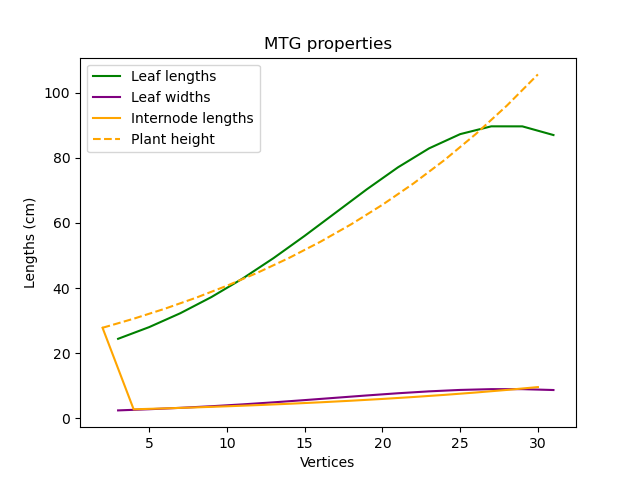

In [17]:
## Imports

# from installed packages
from oawidgets.mtg import *


## Code for exploring the MTG of the generated cereal shoot

# Properties on the MTG: this exclude all the topological properties
print(g_single.property_names())

# Retrieve one property for the MTG (dict)

labels = g_single.property('label')
# print(labels)

length = g_single.property('length')
# print(length)

leaf_lengths=[]
leaf_ind=[]
internode_lengths=[]
internode_ind=[]
for k,v in length.items():
    if k%2==0: # could have done it using labels
        internode_ind.append(k)
        internode_lengths.append(v)
    else:
        leaf_ind.append(k)
        leaf_lengths.append(v)

width = g_single.property('shape_max_width')

leaf_widths=[]
for k,v in width.items():
    leaf_widths.append(v)


plt.figure()
plt.plot(leaf_ind, leaf_lengths, c="green", label="Leaf lengths") # == 'shape_mature_length' for final plant
plt.plot(leaf_ind, leaf_widths, c="purple", label="Leaf widths")
plt.plot(internode_ind, internode_lengths, c="orange", label="Internode lengths")
plt.plot(internode_ind, np.cumsum(internode_lengths), c="orange", label="Plant height", ls='--')
plt.xlabel("Vertices")
plt.ylabel("Lengths (cm)")
plt.title("MTG properties")
plt.legend()
plt.show()

The leaf lengths and widths follow the bell shaped curve described before.  
The first internode in the MTG actually corresponds to the pseudostem, i.e. the about 4 to 8 short first internodes that rapidly lose their leaves. The lengths following internodes follow the geometric model described before.

In [20]:
#| echo: false

# classes = list(set(g.class_name(vid) for vid in g.vertices() if g.class_name(vid)))
# print(classes)

# def vertices(g, class_name='P'):
#     return [vid for vid in g.vertices() if g.class_name(vid)==class_name]

# vids_U = vertices(g, 'U')

# plot(g_single, selection=vids_U)

# plot(g_single, selection=[vid for vid in g_single.vertices() if g_single.class_name(vid)=='LeafElement'])

### A cereal crop with variability

In [21]:
## Imports

# from installed packages
from random import *

# from archicrop
from archicrop.stand import agronomic_plot

# Enable plotting with PlantGL
%gui qt

## Code for generating a random cereal crop from descritive parameters with variability 
# Fix a seed
seed(1)

# Initialize the list of plants
plants_in_crop=[]

# Fixed parameters for all plants
length_plot=5
width_plot=5
sowing_density=10
plant_density=10
inter_row=0.5
nplants, positions, domain, domain_area, unit = agronomic_plot(length_plot, 
                                                               width_plot, 
                                                               sowing_density, 
                                                               plant_density, 
                                                               inter_row, 
                                                               noise=0.1)

# For loop over all the plants in the crop
for n in range(nplants):
    # Parameters varying among plants
    stem_radius=1 
    height=1000*(1+random()-0.5) 
    nb_phy=15 
    max_leaf_length=50*(1+random()-0.5)
    insertion_angle=40*(1+random()-0.5)
    scurv=0.7*(1+random()-0.5)
    curvature=70*(1+random()-0.5)
    phyllotactic_angle=137*(1+random()-0.5)
    spiral=True

    # Functions calls
    insertion_heights=np.array(geometric_dist(height, nb_phy, q=1.2)) 
    leaf_lengths=np.array(bell_shaped_dist(max_leaf_length=max_leaf_length, nb_phy=nb_phy, rmax=0.7, skew=0.15)) 
    a_leaf = parametric_leaf(nb_segment=10, insertion_angle=insertion_angle, scurv=scurv, curvature=curvature, alpha=-2.3)
    leaf_shapes = [a_leaf for l in leaf_lengths]
    leaf_azimuths = leaf_azimuth(size=len(leaf_lengths), phyllotactic_angle=phyllotactic_angle, phyllotactic_deviation=15, 
                                 plant_orientation=random()*360, spiral=spiral)
    shoot, g_var = build_shoot(stem_radius=stem_radius, insertion_heights=insertion_heights, leaf_lengths=leaf_lengths, 
                               leaf_areas=None, leaf_shapes=leaf_shapes, leaf_azimuths=leaf_azimuths)

    # Fill the list of plants
    plants_in_crop.append(g_var)

# Build and display scene
scene_var, nump = build_scene(plants_in_crop, positions, leaf_material=Material(nice_green), stem_material=Material(nice_green))
# display_scene(scene_var)
PlantGL(scene_var)

    plant  ntop    L_blade   W_blade     S_blade      h_ins  L_sheath  \
0       1    15  20.585953  2.058595   31.783610   7.378346         0   
1       1    14  24.322820  2.432282   44.369967   8.854015         0   
2       1    13  28.593003  2.859300   61.316986  10.624818         0   
3       1    12  33.330651  3.333065   83.319924  12.749781         0   
4       1    11  38.397353  3.839735  110.576756  15.299737         0   
5       1    10  43.567989  4.356799  142.362722  18.359685         0   
6       1     9  48.526362  4.852636  176.610584  22.031622         0   
7       1     8  52.877052  5.287705  209.698694  26.437946         0   
8       1     7  56.178648  5.617865  236.703034  31.725535         0   
9       1     6  57.999621  5.799962  252.296701  38.070643         0   
10      1     5  57.991471  5.799147  252.225801  45.684771         0   
11      1     4  55.965896  5.596590  234.913616  54.821725         0   
12      1     3  51.956328  5.195633  202.459499  6

Plot(antialias=3, axes=['x', 'y', 'z'], axes_helper=1.0, axes_helper_colors=[16711680, 65280, 255], background…

### A seemingly growing plant

In [22]:
## Inputs

# from installed packages
from openalea.plantgl.all import *

# Enable plotting with PlantGL
%gui qt

## Code for generating a "growing" cereal shoot from descritive parameters
# Fix a seed
seed(1)

# Initialize the list of plant MTGs at different stages
growing_plants=[]

# Parameters fixing final plant or unchanged with "growth"
nplants=10
positions=[(x,0,0) for x in range(-500, 500, 100)]
final_height=1000
final_nb_phy=2*nplants
heights=geometric_dist(final_height, final_nb_phy, 1.2)
# insertion_heights=np.array(geometric_dist(height, nb_phy, q=1.2))
stem_radius=2 
insertion_angle=30
scurv=0.7
curvature=100
phyllotactic_angle=137
spiral=True

# For loop for generating plants at different stages
for n in range(1,nplants+1):
    # Parameters varying when "growing"
    height=10*heights[2*n-1]
    nb_phy=2*n 
    max_leaf_length=5*2*n
    
    # Functions calls
    insertion_heights=np.array(geometric_dist(height, nb_phy, q=1.2)) 
    leaf_lengths=np.array(bell_shaped_dist(max_leaf_length=max_leaf_length, nb_phy=nb_phy, rmax=0.7, skew=0.15)) 
    a_leaf = parametric_leaf(nb_segment=10, insertion_angle=insertion_angle, scurv=scurv, curvature=curvature, alpha=-2.3)
    leaf_shapes = [a_leaf for l in leaf_lengths] 
    leaf_azimuths = leaf_azimuth(size=len(leaf_lengths), phyllotactic_angle=phyllotactic_angle, 
                                 phyllotactic_deviation=15, plant_orientation=0, spiral=spiral)
    shoot, g_grow = build_shoot(stem_radius=stem_radius, insertion_heights=insertion_heights, leaf_lengths=leaf_lengths, 
                                leaf_areas=None, leaf_shapes=leaf_shapes, leaf_azimuths=leaf_azimuths)

    # Fill the list with MTG of "growing" plant
    growing_plants.append(g_grow)

# Build and display scene
scene_grow, nump = build_scene(growing_plants[2:], positions[2:], leaf_material=Material(nice_green), stem_material=Material(nice_green))
# display_scene(scene_grow)
PlantGL(scene_grow)

   plant  ntop   L_blade   W_blade   S_blade      h_ins  L_sheath  W_sheath  \
0      1     2  8.723255  0.872326  5.707138  14.650348         0         4   
1      1     1  6.752287  0.675229  3.419503  17.580417         0         4   

   L_internode  W_internode  leaf_azimuth  leaf_rank  \
0    14.650348            4      8.060600          1   
1     2.930070            4    121.063653          2   

                                          leaf_shape  
0  ([0.009510794725133227, 0.04025249471813041, 0...  
1  ([0.009510794725133227, 0.04025249471813041, 0...  
   plant  ntop    L_blade   W_blade    S_blade      h_ins  L_sheath  W_sheath  \
0      1     4  11.026194  1.102619   9.118272  10.319187         0         4   
1      1     3  17.446510  1.744651  22.828554  12.383025         0         4   
2      1     2  19.806487  1.980649  29.422271  14.859629         0         4   
3      1     1  13.504574  1.350457  13.678014  17.831555         0         4   

   L_internode  W_inte

Plot(antialias=3, axes=['x', 'y', 'z'], axes_helper=1.0, axes_helper_colors=[16711680, 65280, 255], background…

### An intercrop organized in rows

In [23]:
## Inputs

# from installed packages
from openalea.plantgl.all import Material, Color3, Shape, Scene, Viewer, Translated, AxisRotated

# Enable plotting with PlantGL
%gui qt

## Code for generating an intercrop from descritive parameters

# Fix a seed
seed(1)

def plant(height, nb_phy, max_leaf_length, phyllotactic_angle, spiral):
    """ return the MTG of a cereal shoot generative from descriptive parameters """
    stem_radius=1 
    insertion_angle=30
    scurv=0.7
    curvature=100
    
    insertion_heights=np.array(geometric_dist(height, nb_phy, q=1.2)) 
    leaf_lengths=np.array(bell_shaped_dist(max_leaf_length=max_leaf_length, nb_phy=nb_phy, rmax=0.7, skew=0.15)) 
    a_leaf = parametric_leaf(nb_segment=10, insertion_angle=insertion_angle, scurv=scurv, curvature=curvature, alpha=-2.3)
    leaf_shapes = [a_leaf for l in leaf_lengths] 
    leaf_azimuths = leaf_azimuth(size=len(leaf_lengths), phyllotactic_angle=phyllotactic_angle, 
                                 phyllotactic_deviation=15, plant_orientation=random()*360, spiral=spiral)
    shoot, g = build_shoot(stem_radius=stem_radius, insertion_heights=insertion_heights, leaf_lengths=leaf_lengths, 
                           leaf_areas=None, leaf_shapes=leaf_shapes, leaf_azimuths=leaf_azimuths)
    
    return g


# Organize the plant mixture in alternate rows
n_rows = 10
len_rows = 10

d_inter = 70
d_intra = 50

def plant_in_row(i):
     if i%(4*d_inter)==0 or i%(4*d_inter)==d_inter: return plant(height=1700, nb_phy=15, max_leaf_length=100, phyllotactic_angle=137, spiral=True)
     else: return plant(height=900, nb_phy=20, max_leaf_length=40, phyllotactic_angle=60, spiral=True)


plants_in_intercrop = [plant_in_row(x) for x in range(0, n_rows*d_inter, d_inter) for y in range(0, len_rows*d_intra, d_intra)]

positions=[(x,y,0) for x in range(0, n_rows*d_inter, d_inter) for y in range(0, len_rows*d_intra, d_intra)]

# Build and display scene
scene_ic, nump = build_scene(plants_in_intercrop, positions, leaf_material=Material(nice_green), stem_material=Material(nice_green))
# display_scene(scene_ic)
PlantGL(scene_ic)

    plant  ntop    L_blade   W_blade     S_blade       h_ins  L_sheath  \
0       1    15  35.346420  3.534642   93.702706   19.441430         0   
1       1    14  41.762681  4.176268  130.809116   23.329715         0   
2       1    13  49.094656  4.909466  180.771394   27.995659         0   
3       1    12  57.229276  5.722928  245.639255   33.594790         0   
4       1    11  65.928887  6.592889  325.996360   40.313748         0   
5       1    10  74.806952  7.480695  419.706010   48.376498         0   
6       1     9  83.320561  8.332056  520.673691   58.051798         0   
7       1     8  90.790767  9.079077  618.222251   69.662157         0   
8       1     7  96.459662  9.645966  697.834973   83.594589         0   
9       1     6  99.586302  9.958630  743.807370  100.313506         0   
10      1     5  99.572309  9.957231  743.598348  120.376207         0   
11      1     4  96.094364  9.609436  692.559508  144.451449         0   
12      1     3  89.209869  8.920987  

Plot(antialias=3, axes=['x', 'y', 'z'], axes_helper=1.0, axes_helper_colors=[16711680, 65280, 255], background…

## Tillering / Branching

In progress ...  

First, basipetal tillers, straight, oriented according to a certain angle, appearing according to a certain timing

In [24]:
#| echo: false

# Copy MTG single plant
g_branch = g_single.sub_mtg(g_single.root)

# g_branch.display()

# REARRANGE MTG WITH SCALES: PLANT, AXE, METAMER (with internode and leaf), ELEMENTS (StemElements and LeafElements)

In [25]:
#| echo: false

# Add branch 

from openalea.mtg import MTG

g = MTG()

plant_id = g.add_component(g.root, label='P1')

# scale 1
v1 = g.add_child(plant_id, label='A1')
v2 = g.add_child(plant_id, label='A2')
v3 = g.add_child(plant_id, label='A3')
v4 = g.add_child(v1, label='I1')
v5 = g.add_child(v1, label='I2')

# g.display()

from oawidgets.mtg import *
# plot(g)

MTG : nb_vertices=7, nb_scales=2
/P1			(id=1)											
	/A1			(id=2)										
		/I1			(id=5)									
		/I2			(id=6)									
	/A2			(id=3)										
	/A3			(id=4)										


## Leaf senescence

In progress ...  

Rate of senescence ? Constant number of leaves on a stem from a certain point or not ?

## Light interception with Caribu

In progress ...  

We have to configure Caribu to simulate the same light as in STICS

In [26]:
# #| echo: false

## Imports 
from alinea.caribu.CaribuScene import CaribuScene
from alinea.caribu.data_samples import data_path

# ## Code for computing light interception with Caribu
# sky = str(data_path('Turtle16soc.light'))
# # opts = map(str, [data_path('par.opt'), data_path('nir.opt')])

# # complete set of files
# cs = CaribuScene(scene=scene_var, light=sky) # opt=opts, ) #pattern=pattern)
# raw,agg=cs.run(simplify=True)

# # print(raw.keys())

# scene,values = cs.plot(raw['Ei'],display=False)

# v99 = np.percentile(values, 99)
# nvalues=np.array(values)
# nvalues[nvalues>v99]=v99
# values = nvalues.tolist()

# # PlantGL(scene, group_by_color=False, property=values)

In [27]:
## Code for computing light interception with Caribu
sky = str(data_path('Turtle16soc.light'))
# opts = map(str, [data_path('par.opt'), data_path('nir.opt')])

# complete set of files
cs = CaribuScene(scene=scene_ic, light=sky) # opt=opts, ) #pattern=pattern)
raw,agg=cs.run(simplify=True)

scene,values = cs.plot(raw['Ei'],display=False)

v99 = np.percentile(values, 99)
nvalues=np.array(values)
nvalues[nvalues>v99]=v99
values = nvalues.tolist()

PlantGL(scene, group_by_color=False, property=values)

Plot(antialias=3, axes=['x', 'y', 'z'], axes_helper=1.0, axes_helper_colors=[16711680, 65280, 255], background…

In [28]:
## Imports 
from archicrop.light_it import illuminate

## Code for computing light interception with Caribu

cs, raw_ei, agg = illuminate(scene=scene_ic)

scene,values = cs.plot(raw['Ei'],display=False)

v99 = np.percentile(values, 99)
nvalues=np.array(values)
nvalues[nvalues>v99]=v99
values = nvalues.tolist()

PlantGL(scene, group_by_color=False, property=values)

Plot(antialias=3, axes=['x', 'y', 'z'], axes_helper=1.0, axes_helper_colors=[16711680, 65280, 255], background…

## Next steps

- Adapt for different species (parameters for cereals, some functions for legumes)